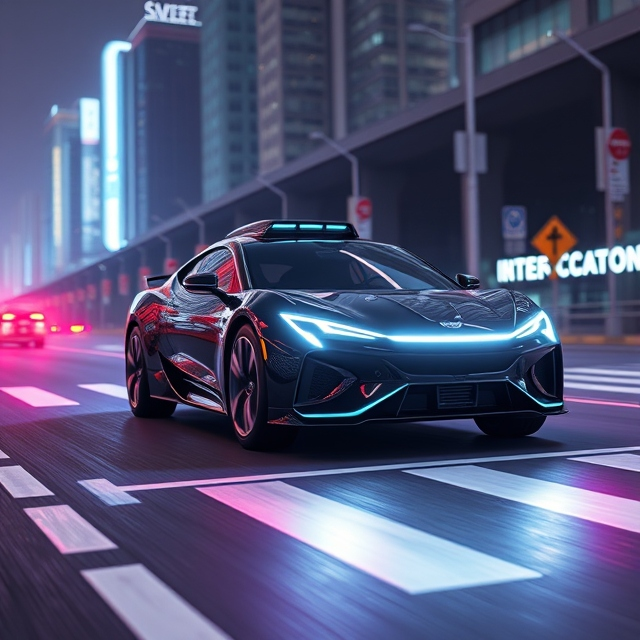

# 1. Import Libraries

In [156]:
import os
import numpy as np
import pandas as pd
import wandb
import yaml
import zipfile
import matplotlib.pyplot as plt
import cv2
from IPython.display import HTML
from matplotlib import animation
from tqdm import tqdm
from PIL import Image
from ultralytics import YOLO
from IPython.display import FileLink

# 2. Wandb

In [98]:
!wandb login

wandb: Currently logged in as: princekhunt01ds (princekhunt-mu). Use `wandb login --relogin` to force relogin


In [99]:
wandb.init(project="road-detection")

# 3. YAML File 

In [79]:
data_yaml = dict(
    train ='/kaggle/working/dataset/train/images',
    val ='/kaggle/working/dataset/val/images',
    test='/kaggle/working/dataset/test/images',
    nc = 9,
    names =['Trafic Light Signal', 'Stop Signal', 'Speedlimit Signal', 'Crosswalk Signal', 'Crosswalk', 'Pedestrian', 'Bus', 'Car', 'Truck']
)

In [80]:
with open('dataset.yaml', 'w') as outfile:
    yaml.dump(data_yaml, outfile, default_flow_style=True)

# 4. Dataset Import 

In [44]:
def create_zip(source_folder, destination_zip):
    with zipfile.ZipFile(destination_zip, 'w', zipfile.ZIP_DEFLATED) as zip_ref:
        for root, dirs, files in os.walk(source_folder):
            for file in files:
                file_path = os.path.join(root, file)
                zip_ref.write(file_path, arcname=os.path.relpath(file_path, source_folder))

In [45]:
def extract_zip(zip_file, destination_folder):
    with zipfile.ZipFile(zip_file, 'r') as zip_ref:
        zip_ref.extractall(destination_folder)

In [46]:
source_folder = '/kaggle/input/road-detection-imgs-and-labels'
destination_zip = '/kaggle/working/dataset.zip'
destination_folder = '/kaggle/working/'

create_zip(source_folder, destination_zip)
extract_zip(destination_zip, destination_folder)

# 5. Train

In [20]:
model = YOLO("yolo11m.pt") 

100%|██████████| 38.8M/38.8M [00:00<00:00, 137MB/s] 


In [106]:
!yolo task=detect mode=train model=yolo11m.pt data=dataset.yaml epochs=25 imgsz=640

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=dataset.yaml, epochs=25, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, l

In [158]:
!zip -r runs.zip runs/

updating: runs/ (stored 0%)
updating: runs/detect/ (stored 0%)
updating: runs/detect/train/ (stored 0%)
updating: runs/detect/train/val_batch1_labels.jpg (deflated 11%)
updating: runs/detect/train/confusion_matrix.png (deflated 24%)
updating: runs/detect/train/F1_curve.png (deflated 5%)
updating: runs/detect/train/labels.jpg (deflated 20%)
updating: runs/detect/train/train_batch1.jpg (deflated 3%)
updating: runs/detect/train/val_batch2_pred.jpg (deflated 8%)
updating: runs/detect/train/train_batch1185.jpg (deflated 8%)
updating: runs/detect/train/confusion_matrix_normalized.png (deflated 20%)
updating: runs/detect/train/train_batch1186.jpg (deflated 8%)
updating: runs/detect/train/val_batch2_labels.jpg (deflated 8%)
updating: runs/detect/train/val_batch1_pred.jpg (deflated 11%)
updating: runs/detect/train/events.out.tfevents.1733915141.55ff009e679c.1235.0 (deflated 93%)
updating: runs/detect/train/train_batch1187.jpg (deflated 10%)
updating: runs/detect/train/results.png (deflated 7%)


In [159]:
FileLink('runs.zip')

/kaggle/working/runs.zip

# 6. Results

In [128]:
def display_training_results(directory, file_extension=('.jpg', '.png'), images_per_row=2, image_height=10):
    image_paths = []
    for dirname, _, filenames in os.walk(directory):
        for filename in filenames:
            if filename.endswith(file_extension):
                image_paths.append(os.path.join(dirname, filename))
    image_paths = sorted(image_paths)

    num_images = len(image_paths)
    num_rows = (num_images + images_per_row - 1) // images_per_row  
    figsize = (images_per_row * image_height, num_rows * image_height)
    
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=figsize)
    axes = axes.flatten() 

    for i, path in enumerate(image_paths):
        image = Image.open(path)
        axes[i].imshow(np.array(image))
        axes[i].axis('off') 

    for j in range(len(image_paths), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

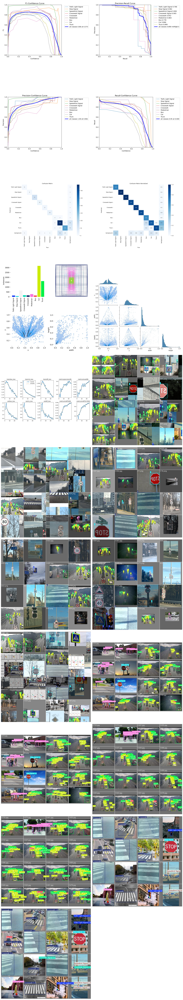

In [129]:
display_training_results('/kaggle/working/runs/detect/train')

# 7. Predict

In [133]:
best_path = 'runs/detect/train/weights/best.pt'
source = 'dataset/test/images'

image_paths = []
for dirname, _, filenames in os.walk(source):
    for filename in filenames:
        if filename.endswith('.jpg') or filename.endswith('.png'): 
            image_paths.append(os.path.join(dirname, filename))
image_paths = sorted(image_paths)

model = YOLO(best_path)

In [134]:
!yolo task=detect mode=predict model={best_path} conf=0.1 source={source}

Ultralytics 8.3.49 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11m summary (fused): 303 layers, 20,036,971 parameters, 0 gradients, 67.7 GFLOPs

image 1/167 /kaggle/working/dataset/test/images/i1040.jpg: 640x640 1 Crosswalk, 17.6ms
image 2/167 /kaggle/working/dataset/test/images/i1042.jpg: 640x640 1 Crosswalk, 17.7ms
image 3/167 /kaggle/working/dataset/test/images/i1043.jpg: 640x640 1 Crosswalk, 17.6ms
image 4/167 /kaggle/working/dataset/test/images/i1054.jpg: 640x640 2 Crosswalks, 17.6ms
image 5/167 /kaggle/working/dataset/test/images/i1056.jpg: 640x640 1 Crosswalk, 17.6ms
image 6/167 /kaggle/working/dataset/test/images/i1057.jpg: 640x640 4 Pedestrians, 17.4ms
image 7/167 /kaggle/working/dataset/test/images/i1068.jpg: 640x640 2 Crosswalks, 17.4ms
image 8/167 /kaggle/working/dataset/test/images/i1260.jpg: 448x640 30 Pedestrians, 44.9ms
image 9/167 /kaggle/working/dataset/test/images/i1261.jpg: 416x640 29 Pedestrians, 43.9ms
image 10/167 /kaggle/working/data

In [135]:
results = model.predict(source, conf=0.1)
results


image 1/167 /kaggle/working/dataset/test/images/i1040.jpg: 640x640 1 Crosswalk, 17.6ms
image 2/167 /kaggle/working/dataset/test/images/i1042.jpg: 640x640 1 Crosswalk, 17.7ms
image 3/167 /kaggle/working/dataset/test/images/i1043.jpg: 640x640 1 Crosswalk, 17.6ms
image 4/167 /kaggle/working/dataset/test/images/i1054.jpg: 640x640 2 Crosswalks, 17.6ms
image 5/167 /kaggle/working/dataset/test/images/i1056.jpg: 640x640 1 Crosswalk, 17.6ms
image 6/167 /kaggle/working/dataset/test/images/i1057.jpg: 640x640 4 Pedestrians, 16.1ms
image 7/167 /kaggle/working/dataset/test/images/i1068.jpg: 640x640 2 Crosswalks, 16.1ms
image 8/167 /kaggle/working/dataset/test/images/i1260.jpg: 448x640 30 Pedestrians, 45.3ms
image 9/167 /kaggle/working/dataset/test/images/i1261.jpg: 416x640 29 Pedestrians, 43.3ms
image 10/167 /kaggle/working/dataset/test/images/i1262.jpg: 448x640 3 Pedestrians, 13.2ms
image 11/167 /kaggle/working/dataset/test/images/i1263.jpg: 448x640 11 Pedestrians, 12.6ms
image 12/167 /kaggle/work

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Trafic Light Signal', 1: 'Stop Signal', 2: 'Speedlimit Signal', 3: 'Crosswalk Signal', 4: 'Crosswalk', 5: 'Pedestrian', 6: 'Bus', 7: 'Car', 8: 'Truck'}
 obb: None
 orig_img: array([[[215, 215, 179],
         [213, 213, 177],
         [210, 210, 174],
         ...,
         [190, 198, 167],
         [189, 197, 166],
         [189, 197, 166]],
 
        [[224, 224, 188],
         [223, 223, 187],
         [221, 221, 185],
         ...,
         [189, 197, 166],
         [188, 196, 165],
         [188, 196, 165]],
 
        [[227, 227, 191],
         [227, 227, 191],
         [228, 228, 192],
         ...,
         [188, 196, 165],
         [187, 195, 164],
         [187, 195, 164]],
 
        ...,
 
        [[190, 191, 149],
         [185, 186, 144],
         [182, 182, 142],
         ...,
         [158, 146, 112],
         [156, 144, 11

In [142]:
paths = []

for dirname, _, filenames in os.walk(source):
    for filename in filenames:
        if filename[-4:] == '.jpg' or filename[-4:] == '.png':
            paths += [(os.path.join(dirname, filename))]
            
paths = sorted(paths)

In [144]:
df = pd.DataFrame(columns = range(6))

for i in range(len(results)):
    arri = pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(float)
    path = paths[i]
    file = path.split('/')[-1]
    arri = arri.assign(file = file)
    arri = arri.assign(i = i)
    df = pd.concat([df, arri], axis = 0)
    
df.columns=['x','y','x2','y2','confidence','class','file','i']
display(df)

/tmp/ipykernel_23/3428083562.py:9: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, arri], axis = 0)


,x,y,x2,y2,confidence,class,file,i
0,2.435278,1.879977,414.100922,416.000000,0.849611,4.0,i1040.jpg,0.0
0,0.000000,4.074917,111.859566,415.693604,0.746792,4.0,i1042.jpg,1.0
0,5.253003,3.204019,413.545135,416.000000,0.862265,4.0,i1043.jpg,2.0
0,0.000000,247.914246,408.056610,352.006195,0.703532,4.0,i1054.jpg,3.0
1,6.363009,209.727432,389.191803,352.568756,0.157361,4.0,i1054.jpg,3.0
...,...,...,...,...,...,...,...,...
2,336.766479,0.000000,360.300903,30.421955,0.117315,5.0,i980.jpg,162.0
0,0.022495,6.581091,329.568054,416.000000,0.861800,4.0,i982.jpg,163.0
0,2.307095,89.366028,410.465820,415.853516,0.841740,4.0,i983.jpg,164.0
0,1.143570,114.424461,413.599976,280.848114,0.758440,4.0,i996.jpg,165.0


In [151]:
def draw_box(image_index):
    image_path = paths[image_index]
    image = cv2.imread(image_path)
    height, width = image.shape[:2]
    filename = image_path.split('/')[-1]
    
    if not df[df['file'] == filename].empty:
        boxes = df[df['file'] == filename].reset_index(drop=True)

        for box_index in range(len(boxes)):
            label = boxes.loc[box_index, 'class']
            x = int(boxes.loc[box_index, 'x'])
            y = int(boxes.loc[box_index, 'y'])
            x2 = int(boxes.loc[box_index, 'x2'])
            y2 = int(boxes.loc[box_index, 'y2'])
            
            cv2.putText(
                image, f'{label}', (x, int(y - 4)),
                cv2.FONT_HERSHEY_SIMPLEX, 1.0, (0, 255, 0), 2
            )
            cv2.rectangle(image, (x, y), (x2, y2), (0, 255, 0), 2) 
    
    return image

In [152]:
def create_animation(images):
    fig = plt.figure(figsize=(12, 8))
    image_display = plt.imshow(cv2.cvtColor(images[0], cv2.COLOR_BGR2RGB))
    text = plt.text(0.05, 0.05, f'Slide {0}', transform=fig.transFigure, fontsize=14, color='blue')
    plt.axis('off')
    plt.close()

    def animate_func(frame_index):
        image_display.set_array(cv2.cvtColor(images[frame_index], cv2.COLOR_BGR2RGB))
        text.set_text(f'Slide {frame_index}')
        return [image_display]

    return animation.FuncAnimation(fig, animate_func, frames=len(images), interval=1000)

In [153]:
annotated_images = []

for index in tqdm(range(len(paths))):
    annotated_images.append(draw_box(index))

100%|██████████| 167/167 [00:00<00:00, 168.32it/s]


In [157]:
anim = create_animation(annotated_images)
HTML(anim.to_jshtml())

/opt/conda/lib/python3.10/site-packages/matplotlib/animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


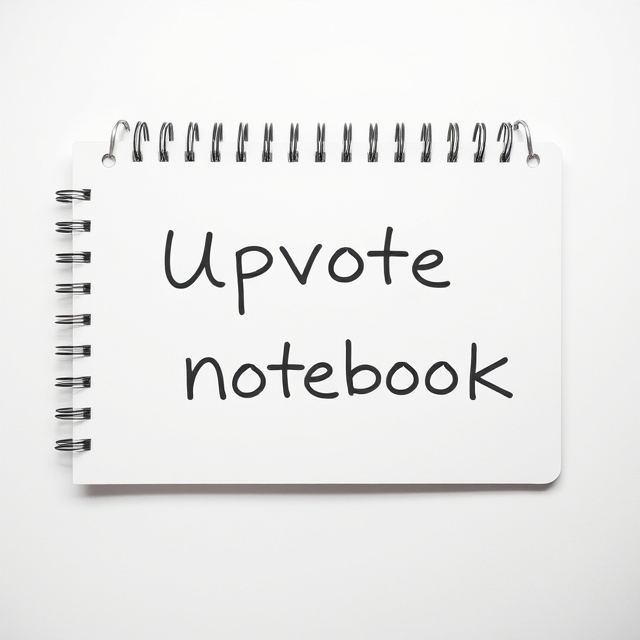